In [1]:
import glob
import numpy as np
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from PIL import Image
from captum.attr import IntegratedGradients
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz
from lucent.optvis import render, param, objectives
from lucent.optvis.objectives import diversity

In [3]:
class CNN(nn.Module):  
    def __init__(self, num_classes, model='resnet50'): 
        super(CNN, self).__init__()         
        self.num_classes = num_classes 
        self.chosen_model = model         
        if self.chosen_model=='densenet121':             
            self.model = models.densenet121(pretrained=True)             
            self.classifier = nn.Sequential( 
                nn.Dropout(p=0.1), 
                nn.Linear(self.model.classifier.in_features, 256, bias=False), 
                nn.ReLU(), 
                nn.BatchNorm1d(256),                 
                nn.Linear(256, 128, bias=False), 
                nn.ReLU(), 
                nn.BatchNorm1d(128),                 
                nn.Linear(128, self.num_classes, bias=False), 
                nn.BatchNorm1d(self.num_classes), 
            )             
            self.model.classifier = self.classifier         
            model_parameters = filter(lambda p: p.requires_grad, self.model.parameters()) 
            params = sum([np.prod(p.size()) for p in model_parameters]) 
    def forward(self, x):         
        return self.model(x) 

In [4]:
checkpoint = torch.load('0.8228 checkpoint.pt', map_location=torch.device('cpu')) 
model = checkpoint['model'] 

In [5]:
model

CNN(
  (model): DenseNet(
    (features): Sequential(
      (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu0): ReLU(inplace=True)
      (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (denseblock1): _DenseBlock(
        (denselayer1): _DenseLayer(
          (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu1): ReLU(inplace=True)
          (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu2): ReLU(inplace=True)
          (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (denselayer2): _DenseLayer(
          (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affi

In [6]:
resize_transform = transforms.Compose([ 
    transforms.ToTensor(), 
    transforms.Resize((224, 224)), 
]) 
norm_transform = transforms.Normalize( 
    mean=[0.485, 0.456, 0.406], 
    std=[0.229, 0.224, 0.225]
) 

In [7]:
all_melanoma_images = glob.glob("lesions_augmented_data/Data/test/Melanoma/*.jpg") 

In [8]:
integrated_gradients = IntegratedGradients(model)
noise_tunnel_applyer = NoiseTunnel(integrated_gradients)
prediction_label_index = 6

/home/dcek/anaconda3/envs/py310/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
/home/dcek/anaconda3/envs/py310/lib/python3.10/site-packages/captum/attr/_utils/visualization.py:51: UserWarning: Attempting to normalize by value approximately 0, visualized resultsmay be misleading. This likely means that attribution values are allclose to 0.
  

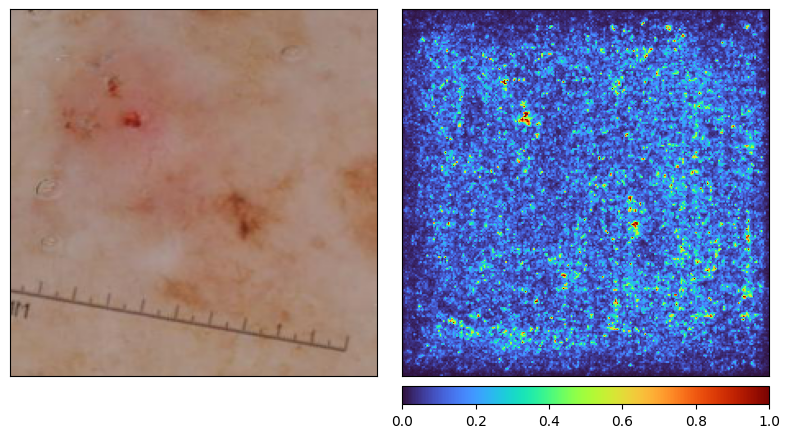

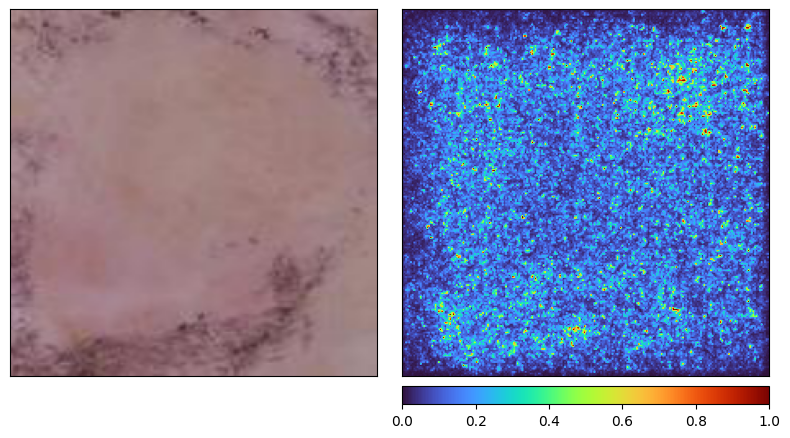

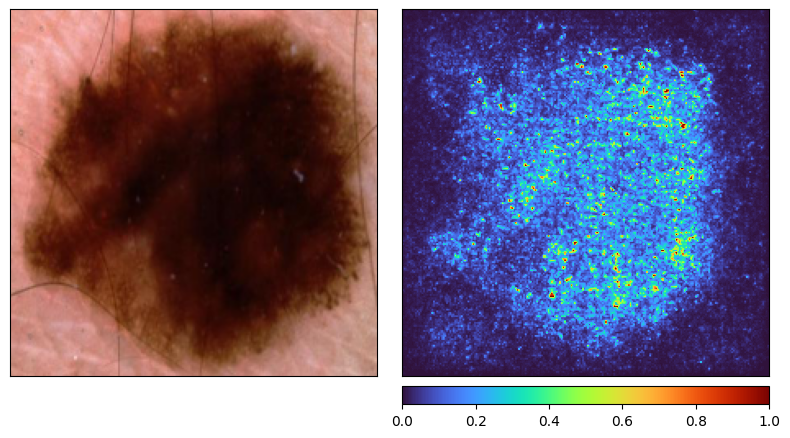

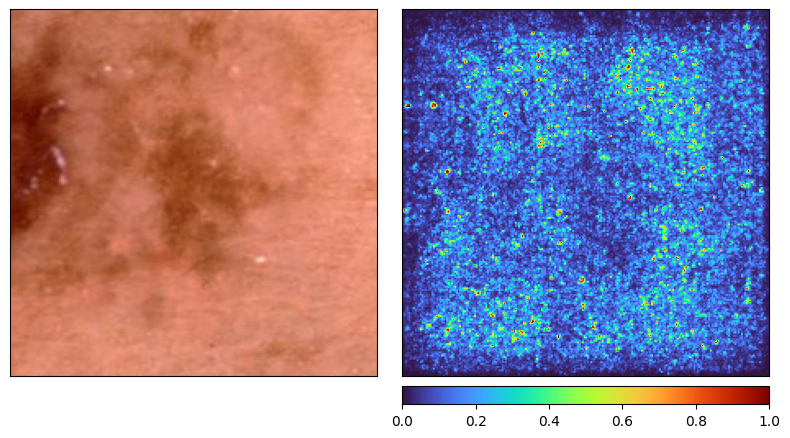

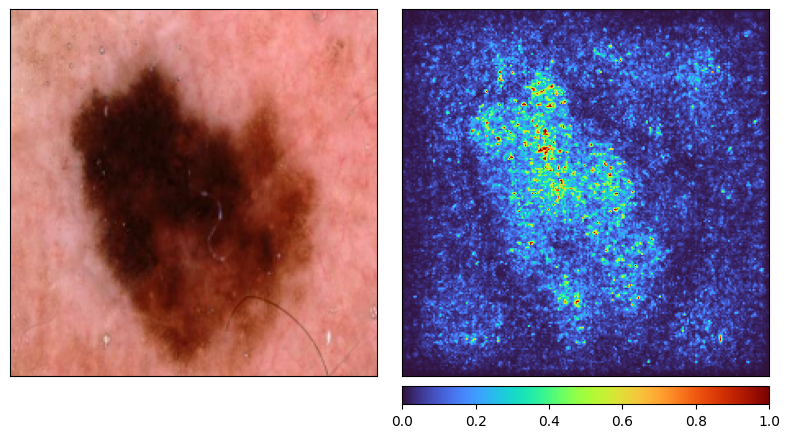

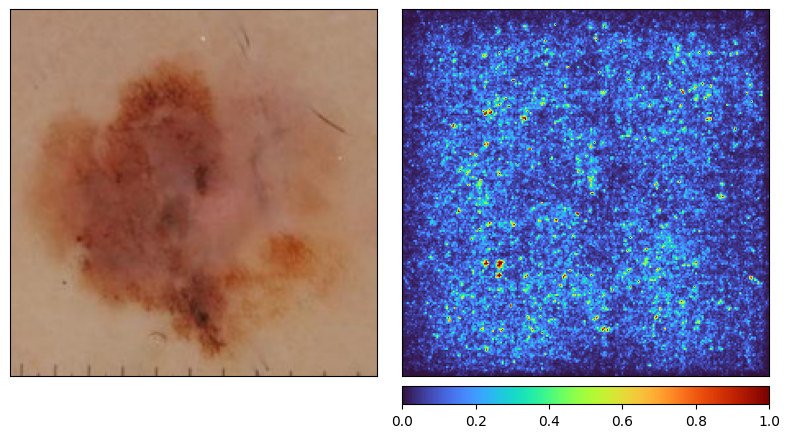

In [9]:
for melanoma_image in all_melanoma_images[:6]: 
    pil_image = Image.open(melanoma_image) 
    img = np.array(pil_image) 
    transformed_image = resize_transform(img) 
    input =  norm_transform(transformed_image).unsqueeze(0) 
    attributions = noise_tunnel_applyer.attribute( 
        input, nt_samples=10, nt_type='smoothgrad_sq', target=prediction_label_index
    ) 
    _ = viz.visualize_image_attr_multiple(   
        np.transpose(attributions.squeeze().cpu().detach().numpy(), (1,2,0)), 
        np.transpose(transformed_image.squeeze().cpu().detach().numpy(), (1,2,0)), 
        ["original_image", "heat_map"], 
        ["all", "positive"], 
        cmap='turbo', 
        show_colorbar=True
    )

In [12]:
cppn_param_f = lambda: param.cppn(224) 
cppn_opt = lambda params: torch.optim.Adam(params, 4e-3) 
param_to_optimize = "classifier_8:{}".format(prediction_label_index)

In [21]:
model.cuda()

CNN(
  (model): DenseNet(
    (features): Sequential(
      (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu0): ReLU(inplace=True)
      (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (denseblock1): _DenseBlock(
        (denselayer1): _DenseLayer(
          (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu1): ReLU(inplace=True)
          (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu2): ReLU(inplace=True)
          (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (denselayer2): _DenseLayer(
          (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affi

Initial loss: 0.856


  1%|▍                                      | 100/10000 [00:11<16:36,  9.93it/s]

Loss at step 101: -4.915



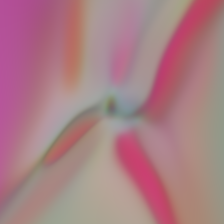

  2%|▊                                      | 201/10000 [00:21<16:14, 10.06it/s]

Loss at step 202: -7.117



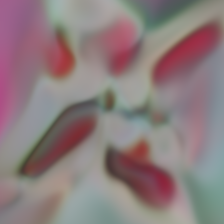

  3%|█▏                                     | 302/10000 [00:31<16:14,  9.96it/s]

Loss at step 303: -8.544



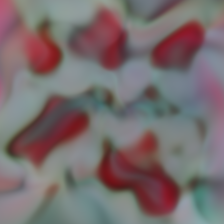

  4%|█▌                                     | 403/10000 [00:40<15:08, 10.56it/s]

Loss at step 404: -10.395



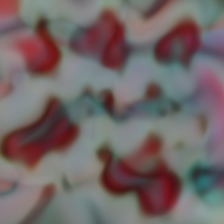

  5%|█▉                                     | 503/10000 [00:50<15:44, 10.06it/s]

Loss at step 505: -10.507



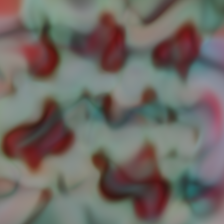

  6%|██▎                                    | 605/10000 [01:00<15:45,  9.94it/s]

Loss at step 606: -10.504



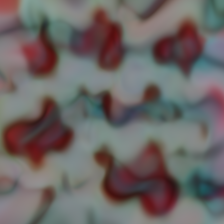

  7%|██▋                                    | 705/10000 [01:10<14:54, 10.39it/s]

Loss at step 707: -11.414



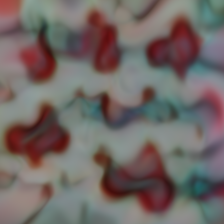

  8%|███▏                                   | 807/10000 [01:20<15:21,  9.97it/s]

Loss at step 808: -10.621



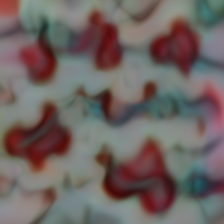

  9%|███▌                                   | 908/10000 [01:29<13:51, 10.93it/s]

Loss at step 909: -11.243



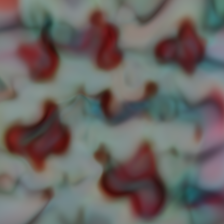

 10%|███▊                                  | 1008/10000 [01:38<12:41, 11.80it/s]

Loss at step 1010: -11.697



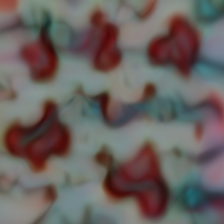

 11%|████▏                                 | 1110/10000 [01:48<14:27, 10.24it/s]

Loss at step 1111: -11.970



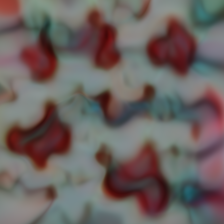

 12%|████▌                                 | 1211/10000 [01:58<14:36, 10.02it/s]

Loss at step 1212: -11.296



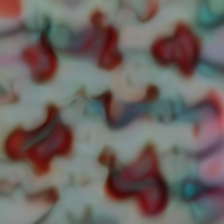

 13%|████▉                                 | 1311/10000 [02:07<14:13, 10.18it/s]

Loss at step 1313: -10.883



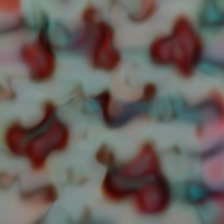

 14%|█████▎                                | 1413/10000 [02:17<14:05, 10.16it/s]

Loss at step 1414: -12.008



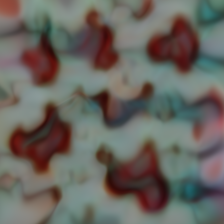

 15%|█████▋                                | 1513/10000 [02:26<09:13, 15.35it/s]

Loss at step 1515: -12.064



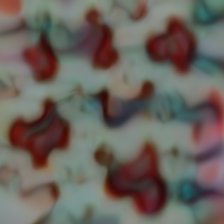

 16%|██████▏                               | 1615/10000 [02:33<13:57, 10.01it/s]

Loss at step 1616: -11.834



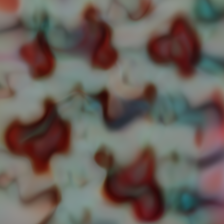

 17%|██████▌                               | 1716/10000 [02:43<13:54,  9.92it/s]

Loss at step 1717: -11.329



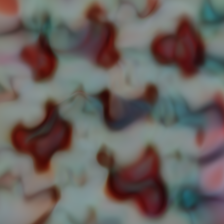

 18%|██████▉                               | 1817/10000 [02:53<13:06, 10.40it/s]

Loss at step 1818: -11.751



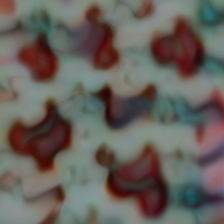

 19%|███████▎                              | 1918/10000 [03:03<13:21, 10.08it/s]

Loss at step 1919: -11.869



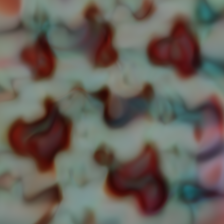

 20%|███████▋                              | 2019/10000 [03:13<13:04, 10.17it/s]

Loss at step 2020: -11.441



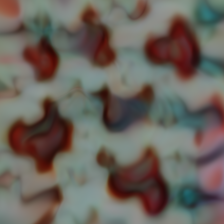

 21%|████████                              | 2120/10000 [03:23<13:02, 10.07it/s]

Loss at step 2121: -11.571



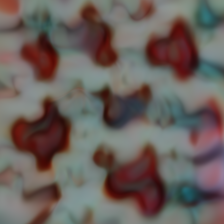

 22%|████████▍                             | 2221/10000 [03:31<08:27, 15.32it/s]

Loss at step 2222: -11.633



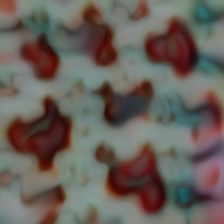

 23%|████████▊                             | 2321/10000 [03:41<12:43, 10.05it/s]

Loss at step 2323: -12.469



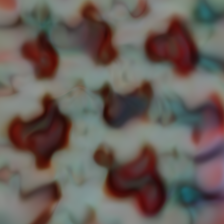

 24%|█████████▏                            | 2422/10000 [03:50<12:28, 10.12it/s]

Loss at step 2424: -11.880



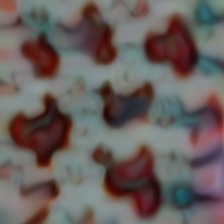

 25%|█████████▌                            | 2523/10000 [04:00<11:57, 10.42it/s]

Loss at step 2525: -11.884



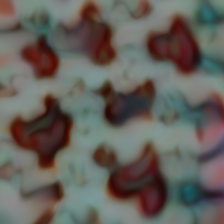

 26%|█████████▉                            | 2624/10000 [04:10<12:14, 10.04it/s]

Loss at step 2626: -11.715



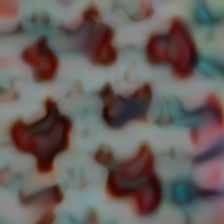

 27%|██████████▎                           | 2726/10000 [04:19<11:55, 10.16it/s]

Loss at step 2727: -11.987



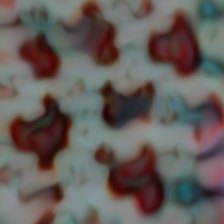

 28%|██████████▋                           | 2826/10000 [04:29<11:53, 10.05it/s]

Loss at step 2828: -12.508



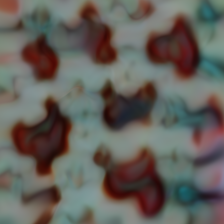

 29%|███████████▏                          | 2928/10000 [04:39<10:28, 11.26it/s]

Loss at step 2929: -12.131



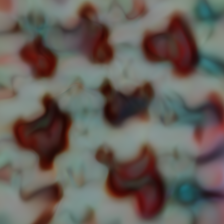

 30%|███████████▌                          | 3028/10000 [04:47<09:54, 11.72it/s]

Loss at step 3030: -12.253



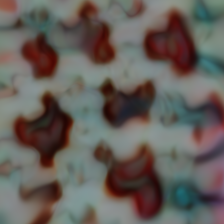

 31%|███████████▉                          | 3130/10000 [04:57<11:29,  9.97it/s]

Loss at step 3131: -12.648



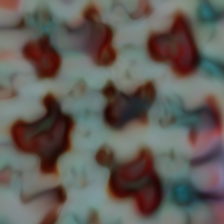

 32%|████████████▎                         | 3231/10000 [05:06<07:22, 15.30it/s]

Loss at step 3232: -12.253



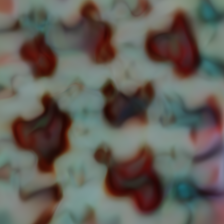

 33%|████████████▋                         | 3331/10000 [05:15<09:49, 11.32it/s]

Loss at step 3333: -12.397



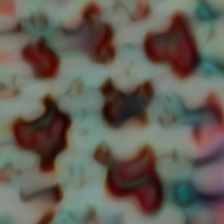

 34%|█████████████                         | 3433/10000 [05:25<10:52, 10.07it/s]

Loss at step 3434: -12.185



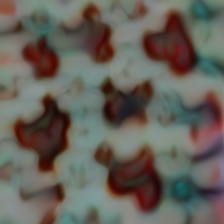

 35%|█████████████▍                        | 3534/10000 [05:35<08:52, 12.15it/s]

Loss at step 3535: -12.661



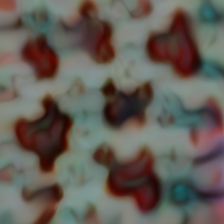

 36%|█████████████▊                        | 3634/10000 [05:44<10:31, 10.08it/s]

Loss at step 3636: -11.444



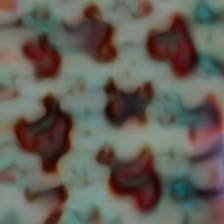

 37%|██████████████▏                       | 3736/10000 [05:54<10:22, 10.06it/s]

Loss at step 3737: -12.028



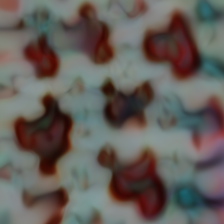

 38%|██████████████▌                       | 3836/10000 [06:03<09:32, 10.77it/s]

Loss at step 3838: -12.532



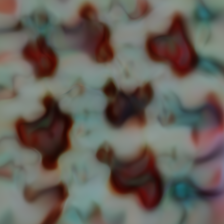

 39%|██████████████▉                       | 3938/10000 [06:13<09:01, 11.20it/s]

Loss at step 3939: -12.336



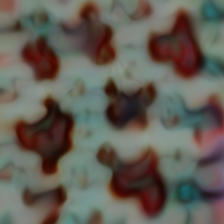

 40%|███████████████▎                      | 4038/10000 [06:23<09:54, 10.03it/s]

Loss at step 4040: -12.172



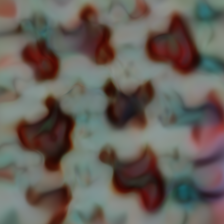

 41%|███████████████▋                      | 4140/10000 [06:32<09:40, 10.09it/s]

Loss at step 4141: -11.834



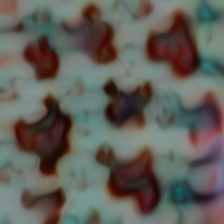

 42%|████████████████                      | 4241/10000 [06:42<09:31, 10.07it/s]

Loss at step 4242: -12.512



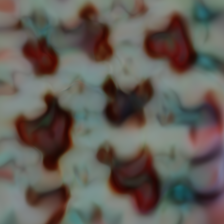

 43%|████████████████▍                     | 4342/10000 [06:52<09:20, 10.09it/s]

Loss at step 4343: -11.728



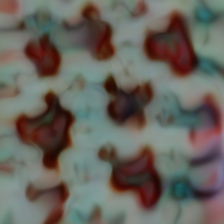

 44%|████████████████▉                     | 4443/10000 [07:02<07:46, 11.91it/s]

Loss at step 4444: -12.392



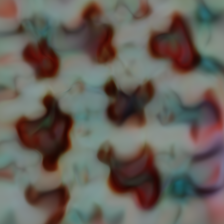

 45%|█████████████████▎                    | 4544/10000 [07:11<08:45, 10.39it/s]

Loss at step 4545: -12.026



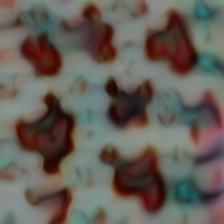

 46%|█████████████████▋                    | 4644/10000 [07:21<08:55, 10.00it/s]

Loss at step 4646: -12.849



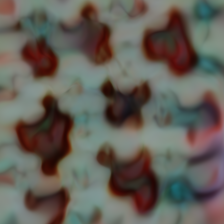

 47%|██████████████████                    | 4745/10000 [07:32<08:49,  9.92it/s]

Loss at step 4747: -12.137



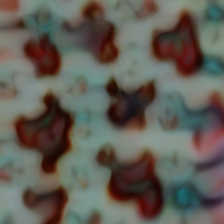

 48%|██████████████████▍                   | 4846/10000 [07:42<08:27, 10.16it/s]

Loss at step 4848: -12.558



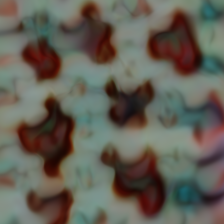

 49%|██████████████████▊                   | 4948/10000 [07:52<08:22, 10.05it/s]

Loss at step 4949: -11.676



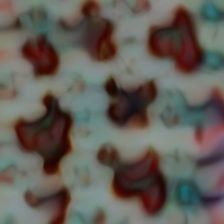

 50%|███████████████████▏                  | 5049/10000 [08:01<07:53, 10.45it/s]

Loss at step 5050: -12.060



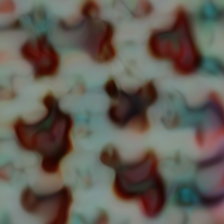

 52%|███████████████████▌                  | 5150/10000 [08:11<07:59, 10.10it/s]

Loss at step 5151: -12.973



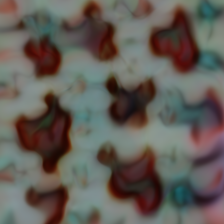

 53%|███████████████████▉                  | 5251/10000 [08:20<07:50, 10.09it/s]

Loss at step 5252: -12.148



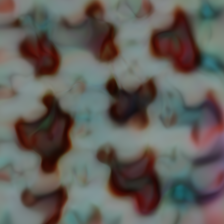

 54%|████████████████████▎                 | 5352/10000 [08:30<07:45,  9.98it/s]

Loss at step 5353: -12.535



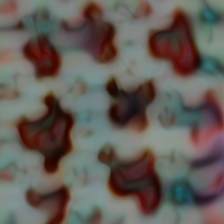

 55%|████████████████████▋                 | 5452/10000 [08:38<04:53, 15.48it/s]

Loss at step 5454: -12.986



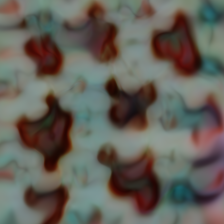

 56%|█████████████████████                 | 5554/10000 [08:47<07:21, 10.07it/s]

Loss at step 5555: -12.247



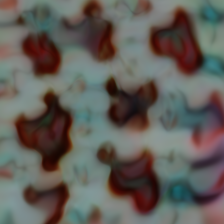

 57%|█████████████████████▍                | 5654/10000 [08:57<07:10, 10.08it/s]

Loss at step 5656: -12.985



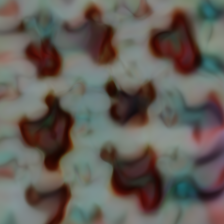

 58%|█████████████████████▊                | 5756/10000 [09:06<06:59, 10.11it/s]

Loss at step 5757: -11.538



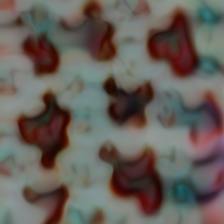

 59%|██████████████████████▎               | 5857/10000 [09:16<06:48, 10.15it/s]

Loss at step 5858: -12.220



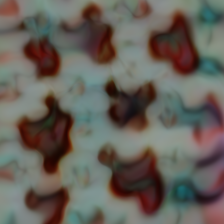

 60%|██████████████████████▋               | 5957/10000 [09:26<06:46,  9.94it/s]

Loss at step 5959: -11.625



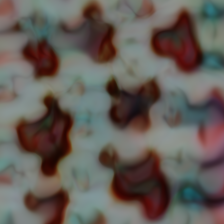

 61%|███████████████████████               | 6058/10000 [09:36<06:16, 10.47it/s]

Loss at step 6060: -12.501



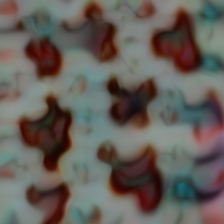

 62%|███████████████████████▍              | 6159/10000 [09:46<06:09, 10.40it/s]

Loss at step 6161: -12.272



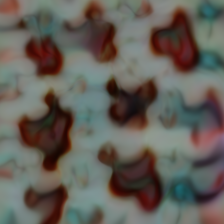

 63%|███████████████████████▊              | 6260/10000 [09:56<05:58, 10.42it/s]

Loss at step 6262: -12.279



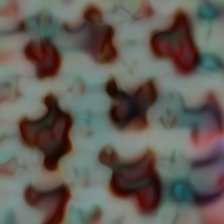

 64%|████████████████████████▏             | 6361/10000 [10:06<05:49, 10.42it/s]

Loss at step 6363: -11.875



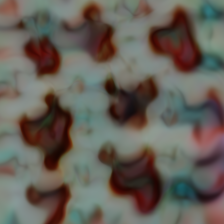

 65%|████████████████████████▌             | 6463/10000 [10:15<04:15, 13.84it/s]

Loss at step 6464: -12.705



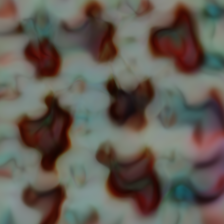

 66%|████████████████████████▉             | 6564/10000 [10:24<05:45,  9.94it/s]

Loss at step 6565: -12.735



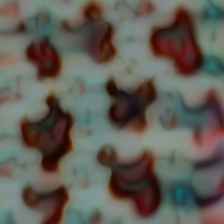

 67%|█████████████████████████▎            | 6664/10000 [10:34<05:30, 10.09it/s]

Loss at step 6666: -12.503



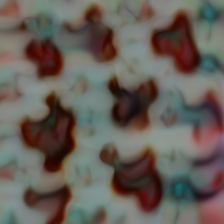

 68%|█████████████████████████▋            | 6766/10000 [10:44<05:18, 10.17it/s]

Loss at step 6767: -12.901



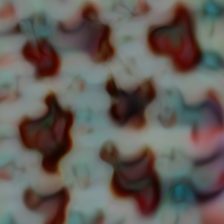

 69%|██████████████████████████            | 6867/10000 [10:54<05:05, 10.24it/s]

Loss at step 6868: -12.396



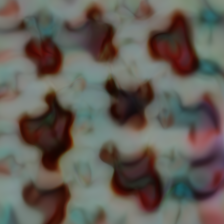

 70%|██████████████████████████▍           | 6967/10000 [11:04<04:51, 10.40it/s]

Loss at step 6969: -13.112



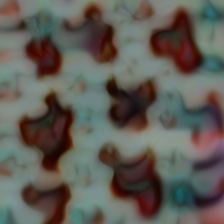

 71%|██████████████████████████▊           | 7068/10000 [11:14<04:37, 10.56it/s]

Loss at step 7070: -11.977



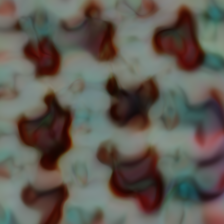

 72%|███████████████████████████▏          | 7169/10000 [11:24<04:40, 10.09it/s]

Loss at step 7171: -12.121



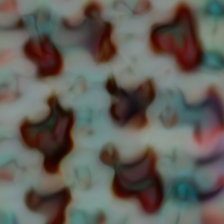

 73%|███████████████████████████▋          | 7271/10000 [11:34<04:27, 10.20it/s]

Loss at step 7272: -12.258



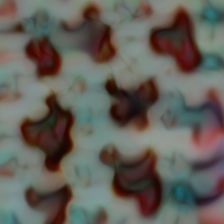

 74%|████████████████████████████          | 7371/10000 [11:44<04:14, 10.34it/s]

Loss at step 7373: -12.497



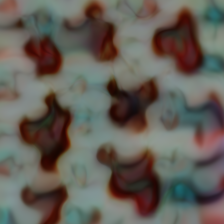

 75%|████████████████████████████▍         | 7472/10000 [11:54<04:00, 10.52it/s]

Loss at step 7474: -11.669



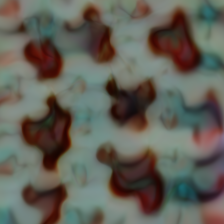

 76%|████████████████████████████▊         | 7574/10000 [12:03<03:56, 10.26it/s]

Loss at step 7575: -12.631



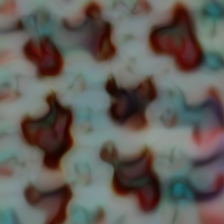

 77%|█████████████████████████████▏        | 7675/10000 [12:13<03:53,  9.96it/s]

Loss at step 7676: -12.698



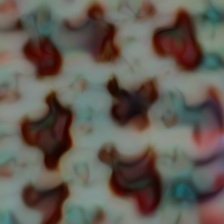

 78%|█████████████████████████████▌        | 7776/10000 [12:22<03:35, 10.31it/s]

Loss at step 7777: -12.816



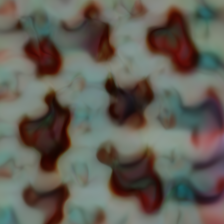

 79%|█████████████████████████████▉        | 7877/10000 [12:32<03:33,  9.97it/s]

Loss at step 7878: -12.095



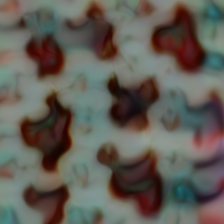

 80%|██████████████████████████████▎       | 7977/10000 [12:42<03:16, 10.29it/s]

Loss at step 7979: -12.328



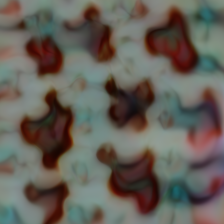

 81%|██████████████████████████████▋       | 8079/10000 [12:51<02:05, 15.25it/s]

Loss at step 8080: -13.190



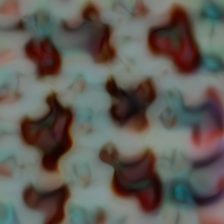

 82%|███████████████████████████████       | 8179/10000 [12:58<01:56, 15.68it/s]

Loss at step 8181: -12.602



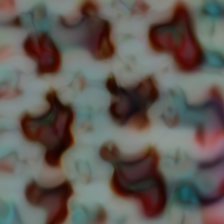

 83%|███████████████████████████████▍      | 8281/10000 [13:05<02:50, 10.08it/s]

Loss at step 8282: -12.041



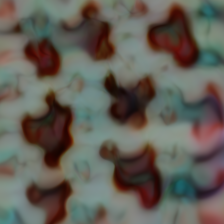

 84%|███████████████████████████████▊      | 8382/10000 [13:15<02:39, 10.12it/s]

Loss at step 8383: -12.802



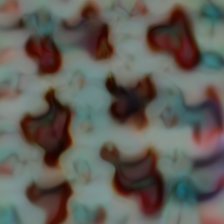

 85%|████████████████████████████████▏     | 8482/10000 [13:25<02:23, 10.61it/s]

Loss at step 8484: -12.147



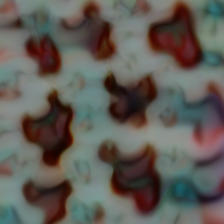

 86%|████████████████████████████████▌     | 8584/10000 [13:35<02:19, 10.18it/s]

Loss at step 8585: -12.888



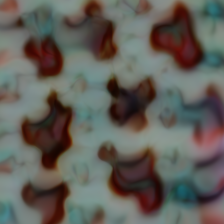

 87%|█████████████████████████████████     | 8685/10000 [13:45<02:12,  9.95it/s]

Loss at step 8686: -12.776



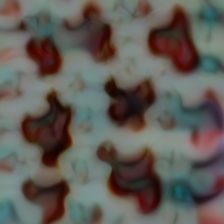

 88%|█████████████████████████████████▍    | 8786/10000 [13:55<02:00, 10.11it/s]

Loss at step 8787: -12.356



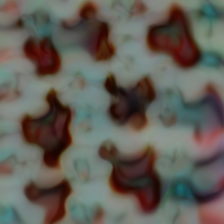

 89%|█████████████████████████████████▊    | 8886/10000 [14:05<01:51, 10.00it/s]

Loss at step 8888: -12.364



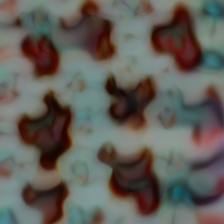

 90%|██████████████████████████████████▏   | 8988/10000 [14:14<01:39, 10.20it/s]

Loss at step 8989: -12.319



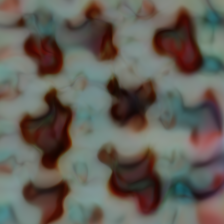

 91%|██████████████████████████████████▌   | 9088/10000 [14:24<01:26, 10.55it/s]

Loss at step 9090: -12.518



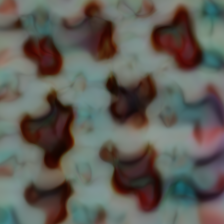

 92%|██████████████████████████████████▉   | 9190/10000 [14:34<01:19, 10.19it/s]

Loss at step 9191: -12.679



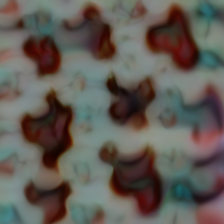

 93%|███████████████████████████████████▎  | 9290/10000 [14:44<01:07, 10.58it/s]

Loss at step 9292: -11.720



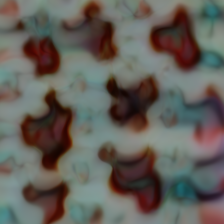

 94%|███████████████████████████████████▋  | 9392/10000 [14:54<01:00,  9.98it/s]

Loss at step 9393: -12.790



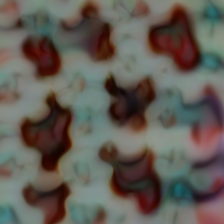

 95%|████████████████████████████████████  | 9492/10000 [15:04<00:49, 10.25it/s]

Loss at step 9494: -12.732



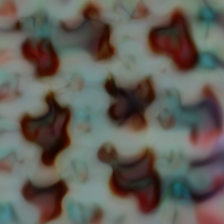

 96%|████████████████████████████████████▍ | 9594/10000 [15:14<00:36, 11.15it/s]

Loss at step 9595: -12.785



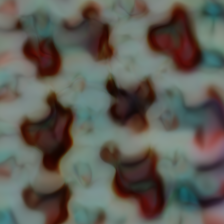

 97%|████████████████████████████████████▊ | 9695/10000 [15:23<00:27, 10.98it/s]

Loss at step 9696: -12.692



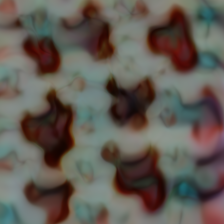

 98%|█████████████████████████████████████▏| 9795/10000 [15:31<00:19, 10.75it/s]

Loss at step 9797: -12.455



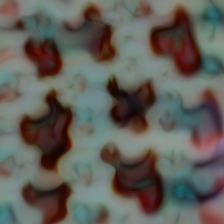

 99%|█████████████████████████████████████▌| 9897/10000 [15:41<00:10, 10.21it/s]

Loss at step 9898: -12.865



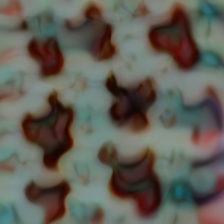

100%|█████████████████████████████████████▉| 9998/10000 [15:51<00:00, 10.75it/s]

Loss at step 10000: -12.565



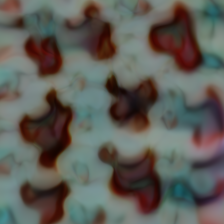

100%|█████████████████████████████████████| 10000/10000 [15:51<00:00, 10.51it/s]



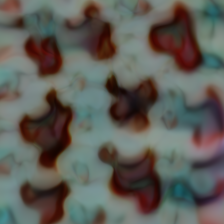

In [22]:
images = render.render_vis( 
    model, param_to_optimize, cppn_param_f, cppn_opt, 
    thresholds=np.linspace(0, 10000, 100, dtype=int).tolist(), 
    verbose=True, 
    show_inline=True 
) 

In [23]:
inference_transform = transforms.Compose([ 
    transforms.ToTensor(), 
    transforms.Resize((224, 224)), 
    transforms.Normalize(mean=[0.485, 0.456, 0.406], 
      std=[0.229, 0.224, 0.225]), 
]) 

In [28]:
def inference_lesion_model(img): 
    transformed_image = inference_transform(img).unsqueeze(0) 
    with torch.no_grad(): 
        output = torch.nn.functional.softmax(model(transformed_image.to(torch.device('cuda'))), dim=1) 
    return output  

output = inference_lesion_model(images[-1].squeeze()) 

Initial loss: 300.791


  2%|▋                                          | 8/500 [00:00<00:44, 11.09it/s]

Loss at step 10: 298.621



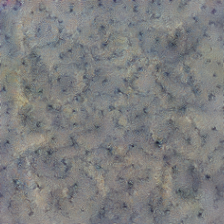
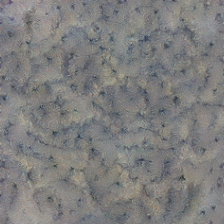
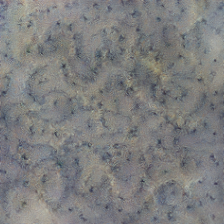
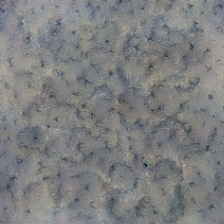

  4%|█▌                                        | 18/500 [00:01<00:46, 10.30it/s]

Loss at step 20: 295.549



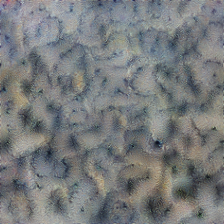
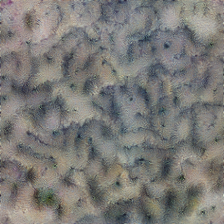
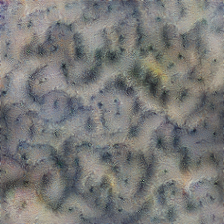
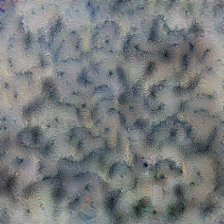

  6%|██▎                                       | 28/500 [00:02<00:45, 10.28it/s]

Loss at step 30: 293.750



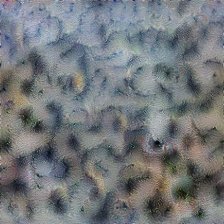
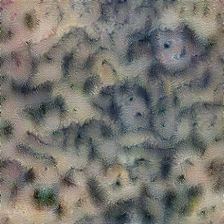
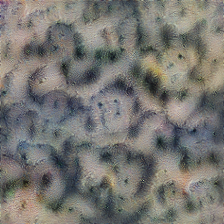
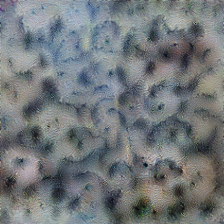

  8%|███▏                                      | 38/500 [00:03<00:45, 10.20it/s]

Loss at step 40: 291.260



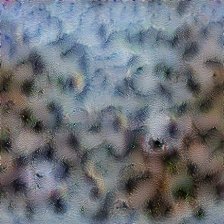
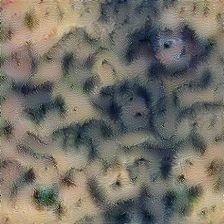
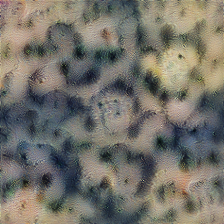
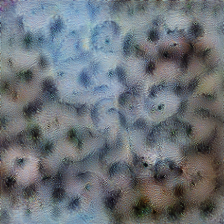

 10%|████▏                                     | 50/500 [00:04<00:44, 10.11it/s]

Loss at step 51: 283.679



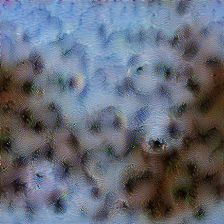
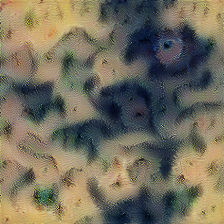
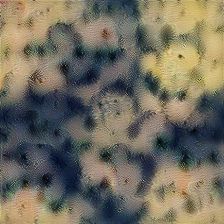
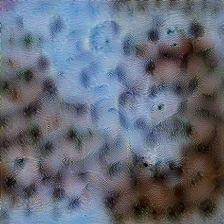

 12%|████▉                                     | 59/500 [00:05<00:43, 10.16it/s]

Loss at step 61: 270.945



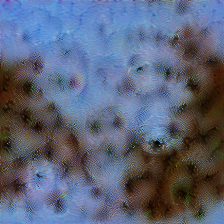
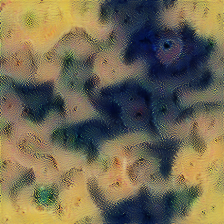
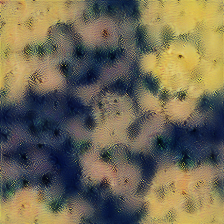
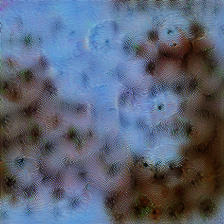

 14%|█████▊                                    | 69/500 [00:06<00:43,  9.89it/s]

Loss at step 71: 250.052



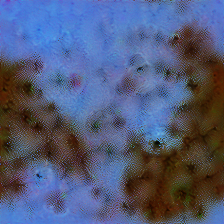
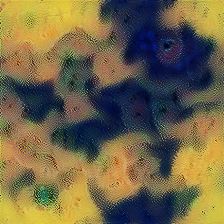
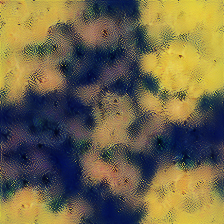
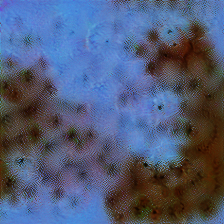

 16%|██████▋                                   | 79/500 [00:07<00:39, 10.62it/s]

Loss at step 81: 223.492



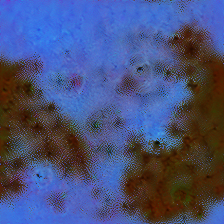
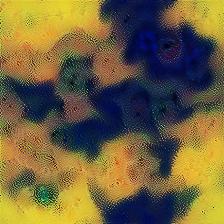
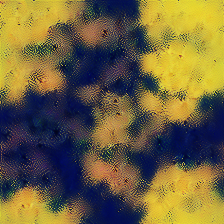
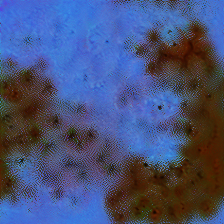

 18%|███████▍                                  | 89/500 [00:08<00:38, 10.73it/s]

Loss at step 91: 197.700



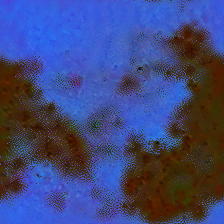
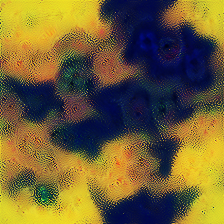
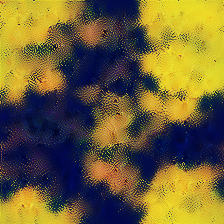
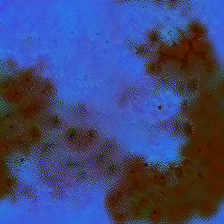

 20%|████████▎                                | 101/500 [00:09<00:36, 10.86it/s]

Loss at step 102: 173.738



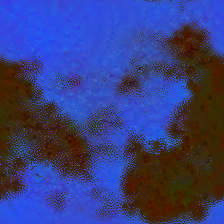
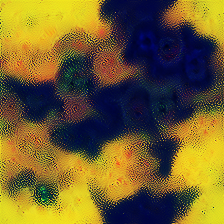
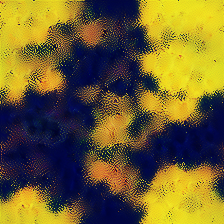
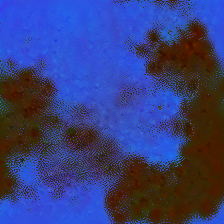

 22%|█████████                                | 111/500 [00:11<00:39,  9.97it/s]

Loss at step 112: 157.348



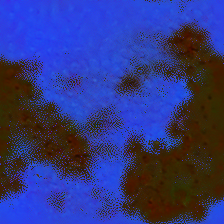
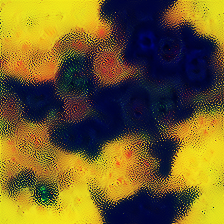
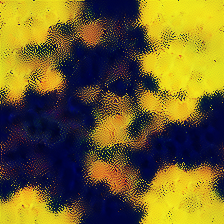
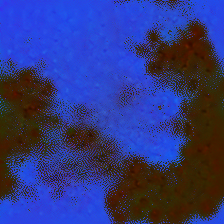

 24%|█████████▉                               | 121/500 [00:12<00:37, 10.05it/s]

Loss at step 122: 145.161



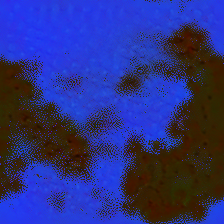
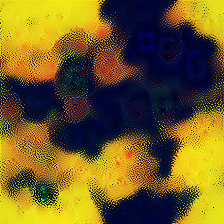
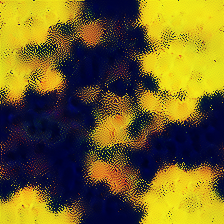
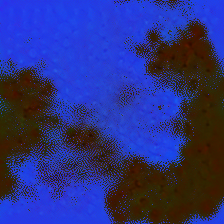

 26%|██████████▋                              | 131/500 [00:13<00:37,  9.78it/s]

Loss at step 132: 136.079



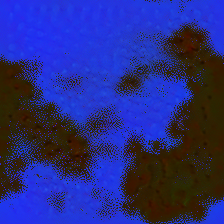
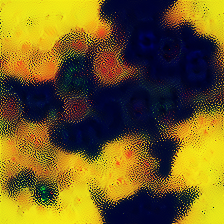
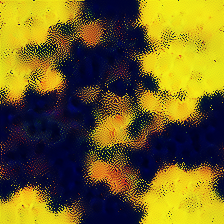
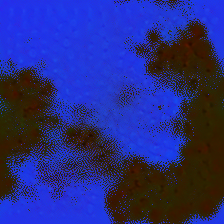

 28%|███████████▍                             | 140/500 [00:14<00:37,  9.50it/s]

Loss at step 142: 129.582



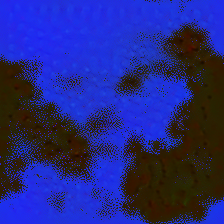
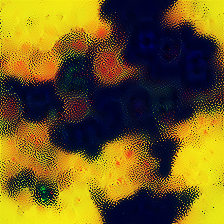
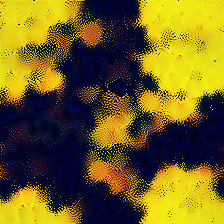
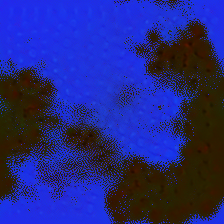

 30%|████████████▍                            | 151/500 [00:15<00:35,  9.79it/s]

Loss at step 153: 123.987



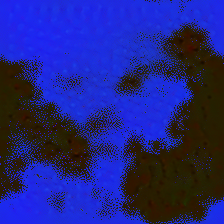
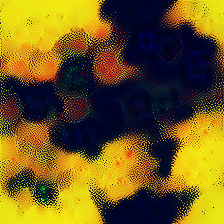
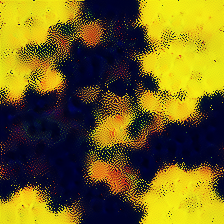
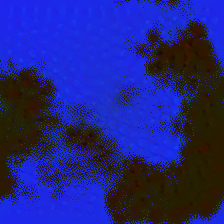

 32%|█████████████▎                           | 162/500 [00:16<00:34,  9.71it/s]

Loss at step 163: 120.270



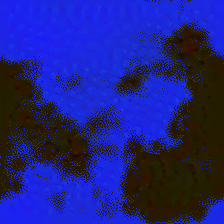
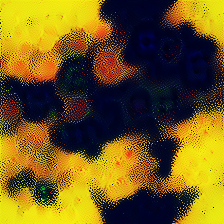
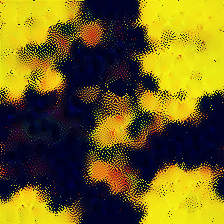
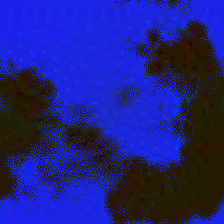

 34%|██████████████                           | 172/500 [00:17<00:34,  9.59it/s]

Loss at step 173: 117.239



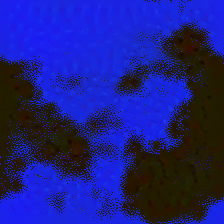
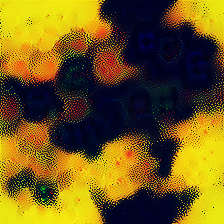
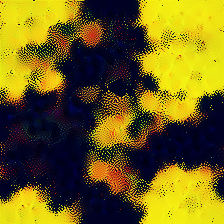
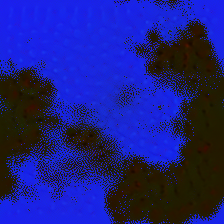

 36%|██████████████▉                          | 182/500 [00:18<00:32,  9.65it/s]

Loss at step 183: 114.595



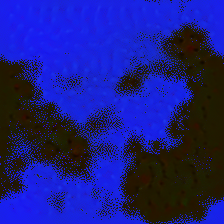
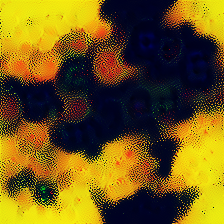
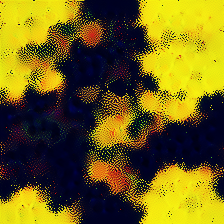
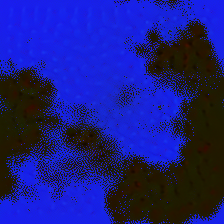

 38%|███████████████▋                         | 191/500 [00:19<00:31,  9.93it/s]

Loss at step 193: 112.671



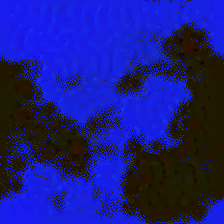
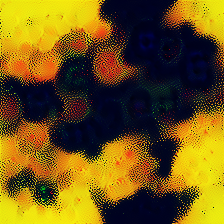
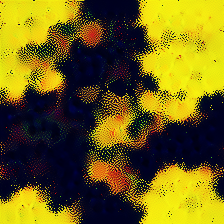
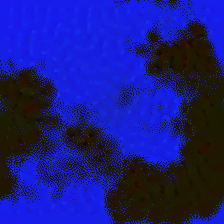

 41%|████████████████▋                        | 203/500 [00:20<00:28, 10.51it/s]

Loss at step 204: 110.663



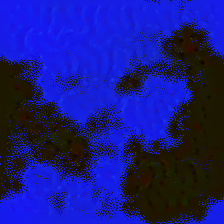
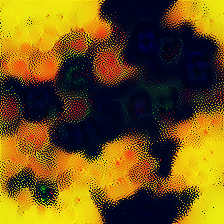
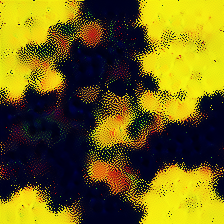
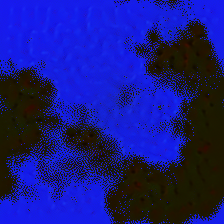

 43%|█████████████████▍                       | 213/500 [00:21<00:25, 11.15it/s]

Loss at step 214: 109.002



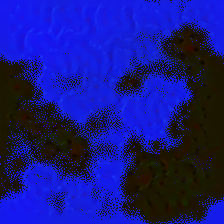
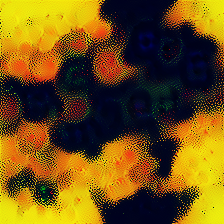
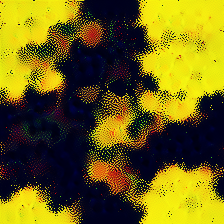
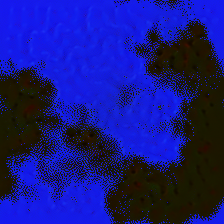

 45%|██████████████████▎                      | 223/500 [00:22<00:22, 12.40it/s]

Loss at step 224: 107.578



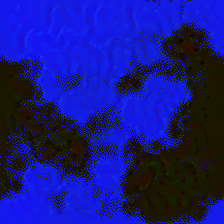
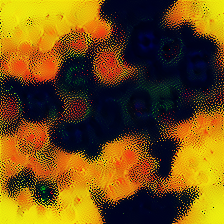
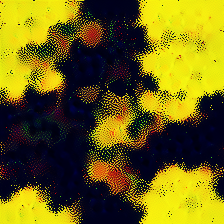
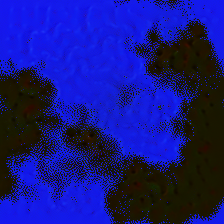

 47%|███████████████████                      | 233/500 [00:23<00:21, 12.61it/s]

Loss at step 234: 105.906



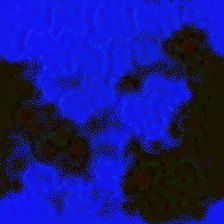
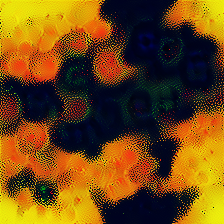
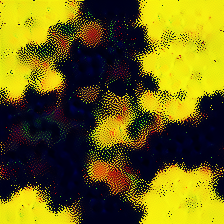
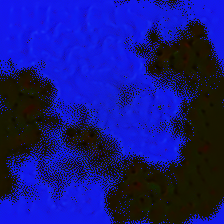

 49%|███████████████████▉                     | 243/500 [00:24<00:20, 12.66it/s]

Loss at step 244: 103.917



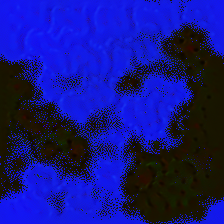
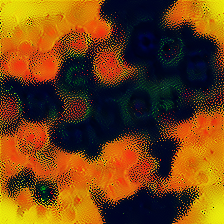
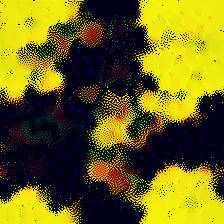
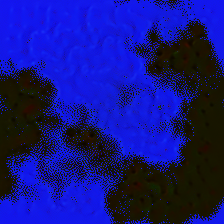

 51%|████████████████████▋                    | 253/500 [00:25<00:19, 12.58it/s]

Loss at step 255: 100.555



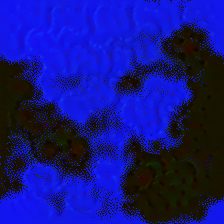
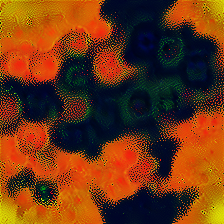
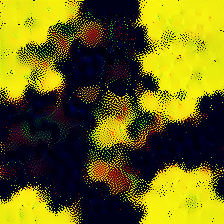
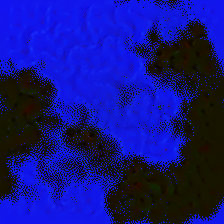

 53%|█████████████████████▌                   | 263/500 [00:25<00:18, 12.67it/s]

Loss at step 265: 96.196



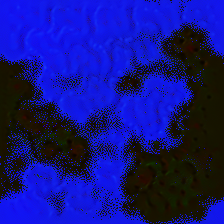
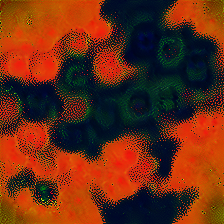
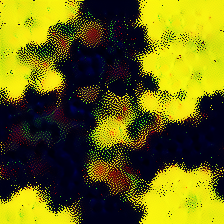
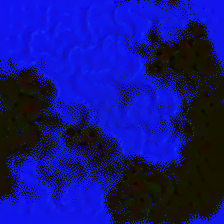

 55%|██████████████████████▍                  | 273/500 [00:26<00:20, 11.21it/s]

Loss at step 275: 91.624



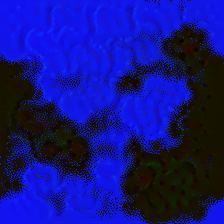
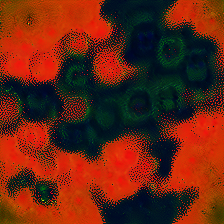
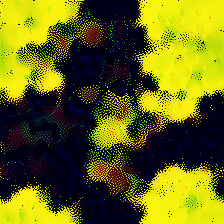
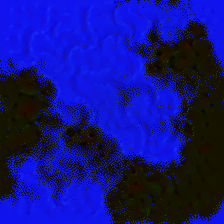

 57%|███████████████████████▏                 | 283/500 [00:27<00:20, 10.61it/s]

Loss at step 285: 87.505



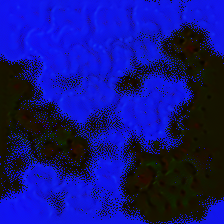
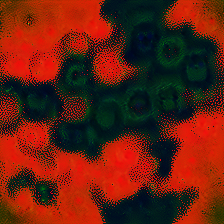
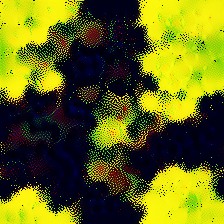
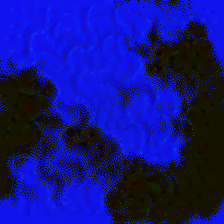

 59%|████████████████████████                 | 293/500 [00:28<00:20, 10.10it/s]

Loss at step 295: 84.231



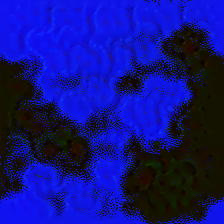
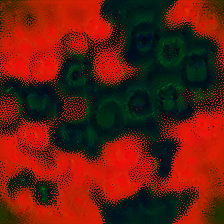
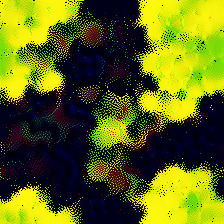
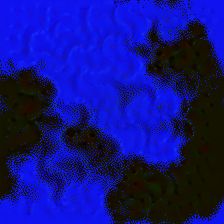

 61%|█████████████████████████                | 305/500 [00:30<00:20,  9.53it/s]

Loss at step 306: 80.864



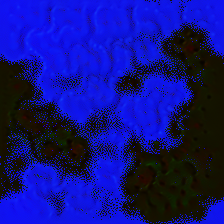
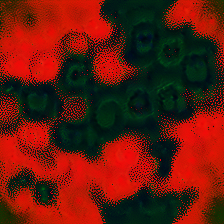
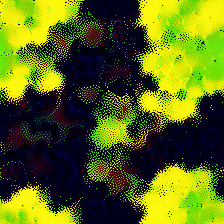
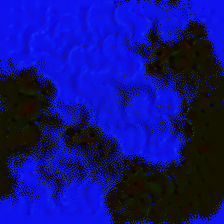

 63%|█████████████████████████▋               | 314/500 [00:31<00:18, 10.24it/s]

Loss at step 316: 78.396



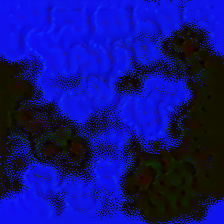
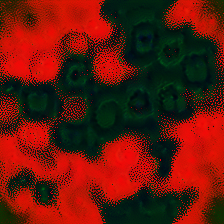
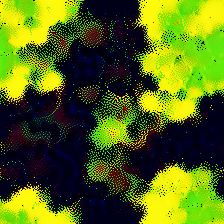
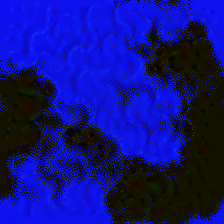

 65%|██████████████████████████▌              | 324/500 [00:32<00:17, 10.17it/s]

Loss at step 326: 76.033



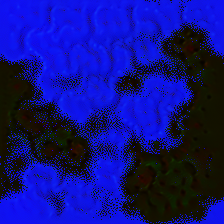
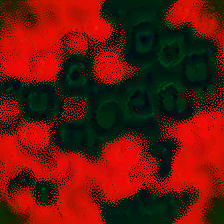
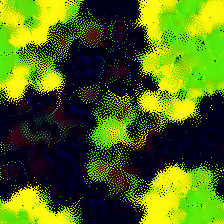
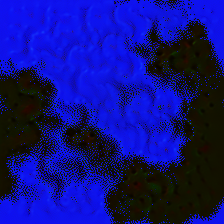

 67%|███████████████████████████▍             | 334/500 [00:33<00:15, 10.69it/s]

Loss at step 336: 73.782



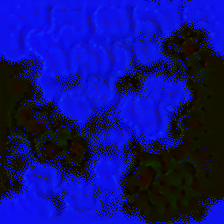
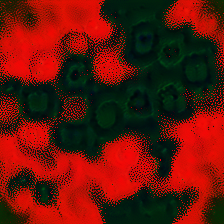
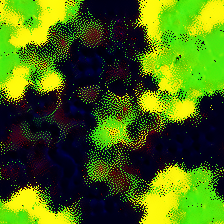
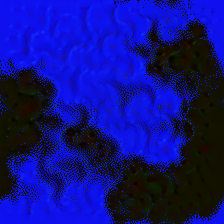

 69%|████████████████████████████▏            | 344/500 [00:34<00:15, 10.19it/s]

Loss at step 346: 71.782



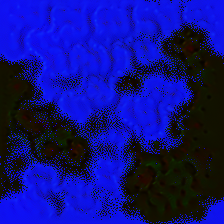
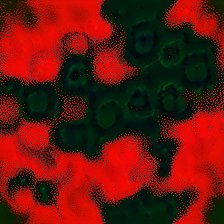
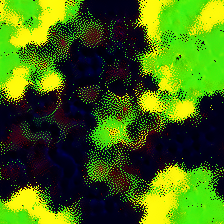
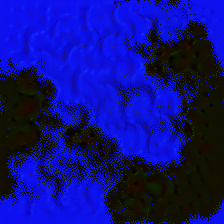

 71%|█████████████████████████████▏           | 356/500 [00:35<00:13, 10.73it/s]

Loss at step 357: 69.503



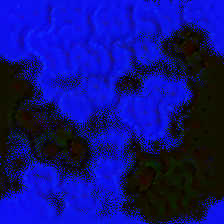
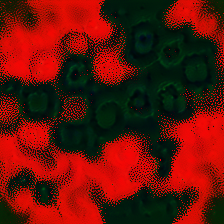
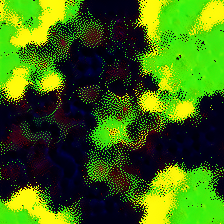
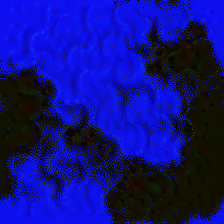

 73%|██████████████████████████████           | 366/500 [00:36<00:13, 10.19it/s]

Loss at step 367: 68.015



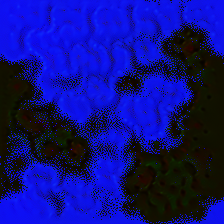
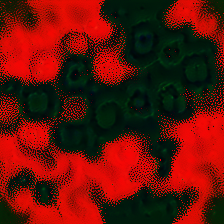
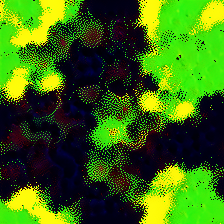
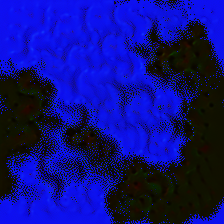

 75%|██████████████████████████████▊          | 376/500 [00:37<00:12, 10.05it/s]

Loss at step 377: 66.850



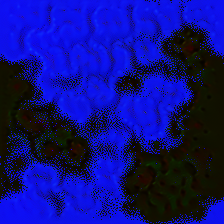
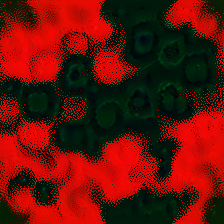
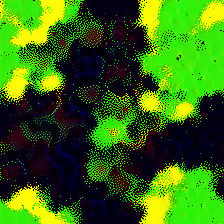
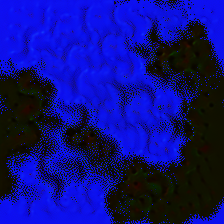

 77%|███████████████████████████████▋         | 386/500 [00:38<00:10, 10.43it/s]

Loss at step 387: 65.517



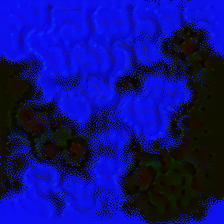
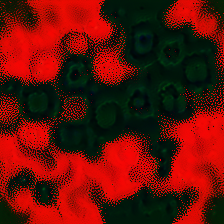
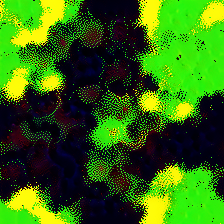
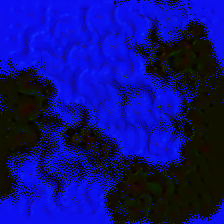

 79%|████████████████████████████████▍        | 396/500 [00:39<00:09, 10.74it/s]

Loss at step 397: 64.369



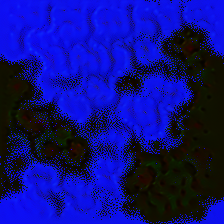
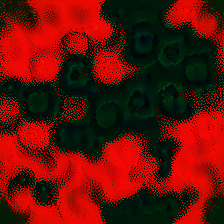
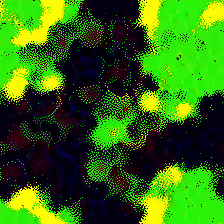
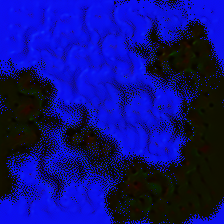

 81%|█████████████████████████████████▎       | 406/500 [00:40<00:08, 11.11it/s]

Loss at step 408: 63.401



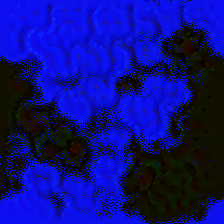
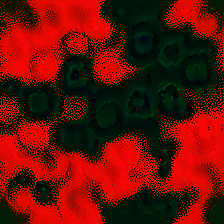
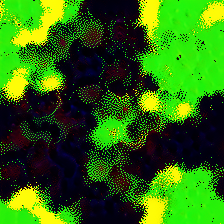
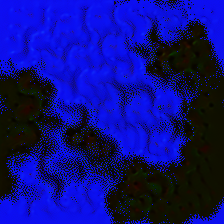

 83%|██████████████████████████████████       | 416/500 [00:41<00:07, 10.79it/s]

Loss at step 418: 62.415



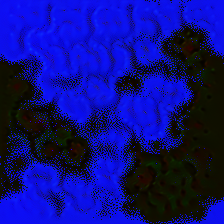
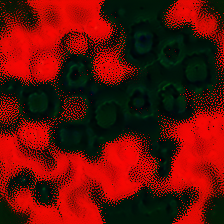
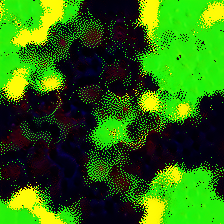
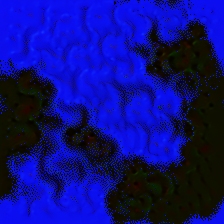

 85%|██████████████████████████████████▉      | 426/500 [00:42<00:07, 10.46it/s]

Loss at step 428: 61.659



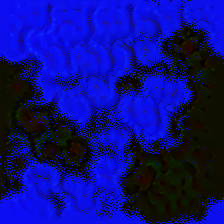
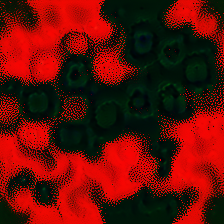
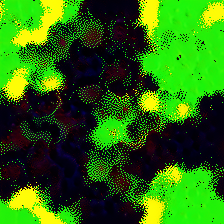
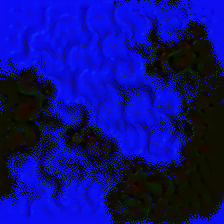

 87%|███████████████████████████████████▊     | 436/500 [00:43<00:06, 10.19it/s]

Loss at step 438: 61.017



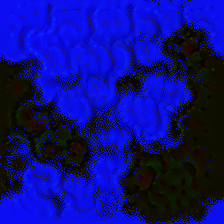
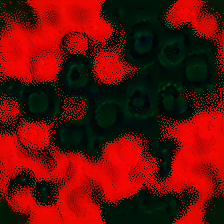
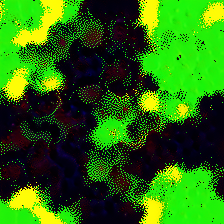
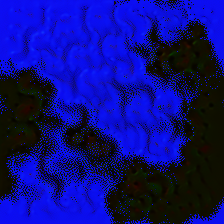

 89%|████████████████████████████████████▌    | 446/500 [00:44<00:05, 10.12it/s]

Loss at step 448: 60.242



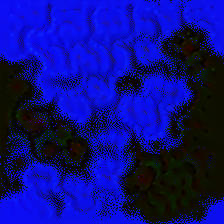
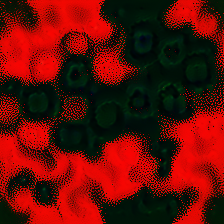
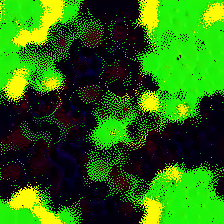
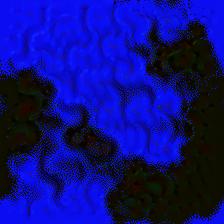

 92%|█████████████████████████████████████▌   | 458/500 [00:45<00:04, 10.34it/s]

Loss at step 459: 59.819



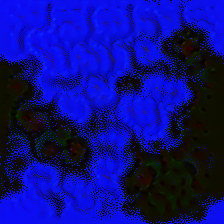
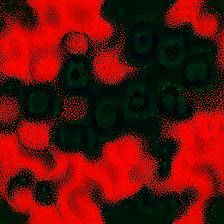
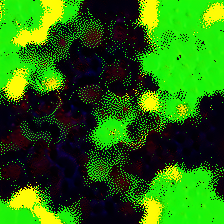
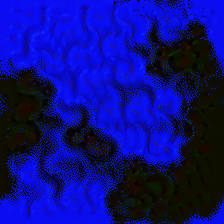

 93%|██████████████████████████████████████▎  | 467/500 [00:46<00:03,  9.57it/s]

Loss at step 469: 59.191



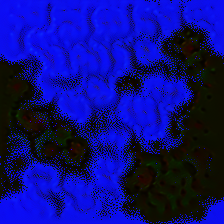
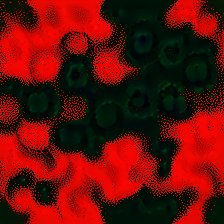
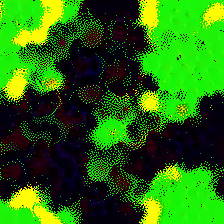
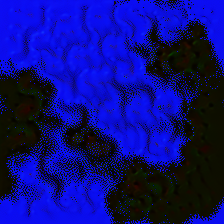

 96%|███████████████████████████████████████▏ | 478/500 [00:47<00:02, 10.19it/s]

Loss at step 479: 58.875



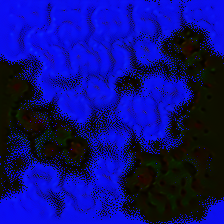
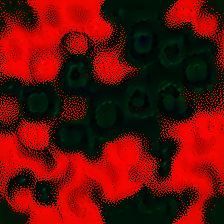
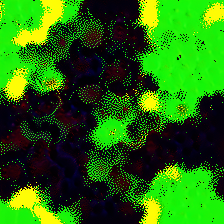
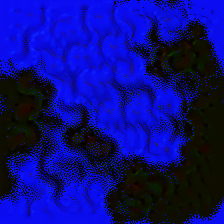

 97%|███████████████████████████████████████▉ | 487/500 [00:48<00:01, 10.33it/s]

Loss at step 489: 58.455



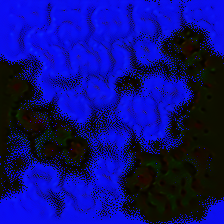
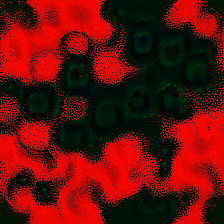
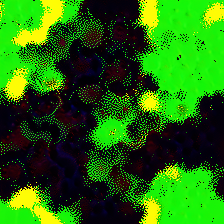
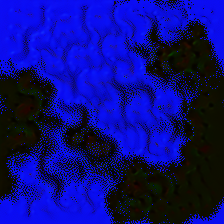

100%|████████████████████████████████████████▉| 499/500 [00:49<00:00, 10.00it/s]

Loss at step 500: 58.242



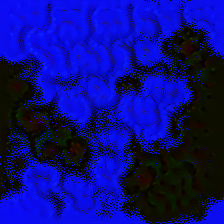
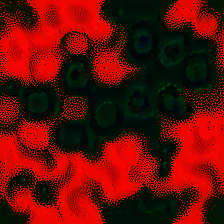
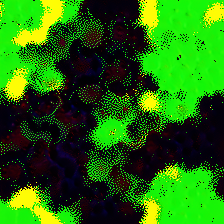
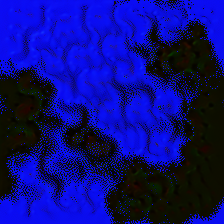

100%|█████████████████████████████████████████| 500/500 [00:49<00:00, 10.00it/s]



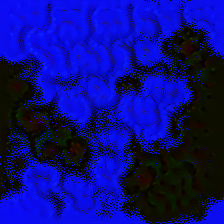
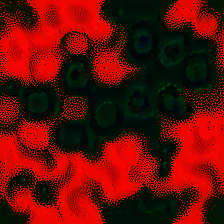
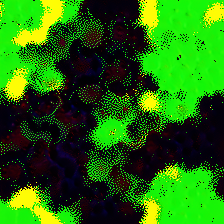
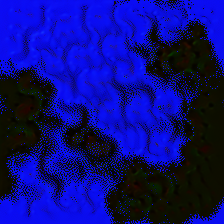

In [170]:
obj = objectives.channel("classifier_8", 6) - 1e2 * diversity("input") 
batch_param_f = lambda: param.image(224, fft=True, decorrelate=True, batch=4) 
batch_images = render.render_vis( 
    model, obj, 
    batch_param_f, 
    thresholds=np.linspace(0, 500, 50, dtype=int).tolist(), 
    show_inline=True, 
    verbose=True, 
) 

In [181]:
outputs = [] 
for img_idx in range(4): 
    img = batch_images[-1][img_idx]
    output = inference_lesion_model(img) 
    outputs.append((output[0][6], output.argmax())) 

/home/dcek/anaconda3/envs/py310/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


In [182]:
outputs

[(tensor(0.9946, device='cuda:0'), tensor(6, device='cuda:0')),
 (tensor(0.9899, device='cuda:0'), tensor(6, device='cuda:0')),
 (tensor(0.7015, device='cuda:0'), tensor(6, device='cuda:0')),
 (tensor(0.9939, device='cuda:0'), tensor(6, device='cuda:0'))]